# Manipulación básica de audio
Autor: Cristian Bautista

In [ ]:
#Ejecutar en caso que las librerías no estén instaladas
!pip install librosa soundfile tqdm

In [ ]:
import librosa
import numpy as np
import matplotlib.pyplot as plt
import librosa.display

# We'll need IPython.display's Audio widget
from IPython.display import Audio

#Para poder guardar en otros formatos (compresiones)
import soundfile as sf

import os
from tqdm import tqdm

In [ ]:
#Importar otras librerías
from scipy.io import wavfile

# Carga de archivos y particularidades

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#Cargar audio con scipy
# 1. Ruta del archivo
filename = "/content/drive/MyDrive/Datasets/TemaGuitarra.wav"
print(filename)

# 2. Cargar forma de audio en la variable "y2" frecuencia de muestreo "fs"
fs, y2 = wavfile.read(filename)  # y2 vector de datos
print("Frecuencia de muestreo:", fs)
print("Tipo de dato: ", y2.dtype)
print("Forma del vector original:", y2.shape)
#Es necesario reestructurar el vector sino hay error con la reproducción
y2 = y2.T
print("Forma del vector modficada:", y2.shape)
print("Primeros 5 valores de ambos canales:", y2[:,:5])

# 3. Reproducir audio
Audio(data=y2, rate=fs)

/content/drive/MyDrive/Datasets/TemaGuitarra.wav


<ipython-input-6-2538085522>:7: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, y2 = wavfile.read(filename)  # y2 vector de datos


Frecuencia de muestreo: 44100
Tipo de dato:  int16
Forma del vector original: (1174824, 2)
Forma del vector modficada: (2, 1174824)
Primeros 5 valores de ambos canales: [[ 0  0  1 -2  3]
 [ 1 -2  2 -1  0]]


In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filename = "/content/drive/MyDrive/Datasets/TemaGuitarra.wav"
print(filename)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
y, sr = librosa.load(filename, sr=None, mono=False)

#Completa el siguiente código para que muestre lo indicado
print("Frecuencia de muestreo:", ) #TBD
print("Tipo de dato: ", )   #TBD
print("Forma del vector y:", )   #TBD
print("Primeros 5 valores de ambos canales:",)   #TBD

# 3. Reproducir audio
Audio(data=y, rate=sr)

/content/drive/MyDrive/Datasets/TemaGuitarra.wav
Frecuencia de muestreo:
Tipo de dato: 
Forma del vector y:
Primeros 5 valores de ambos canales:


# Visualizar respuesta en el tiempo  **

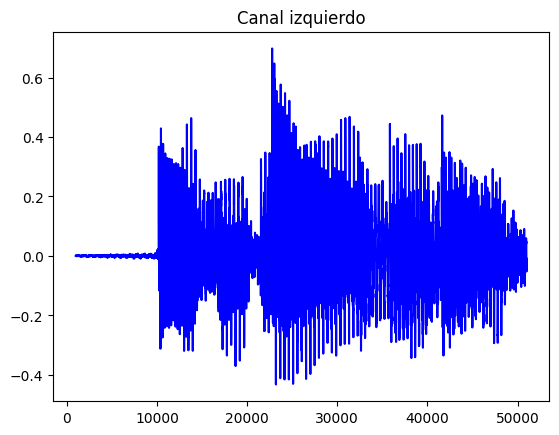

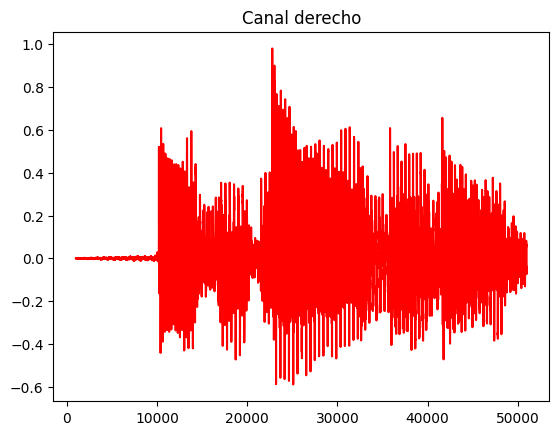

In [ ]:
#Graficar
#Cambia los valores de n y offset para ver la señal en diferentes intervalos y zoom (ejm. n=500, offset=1000)
#El eje X está en muestras del vector de audio, cómo lo muestras en segundos?
#Visualiza los primeros 3 segundos de la señal, que n pondrías?

n= 50000    #TBD #Para determinar el número de muestras a graficar
offset= 1000    #TBD #Para empezar de cualquier parte del vector
time=np.arange(offset,offset+n)
plt.title("Canal izquierdo")
plt.plot(time, y[0, offset:(offset+n)], color='b')
plt.show()

plt.title("Canal derecho")
plt.plot(time, y[1, offset:(offset+n)], color='r')
plt.show()

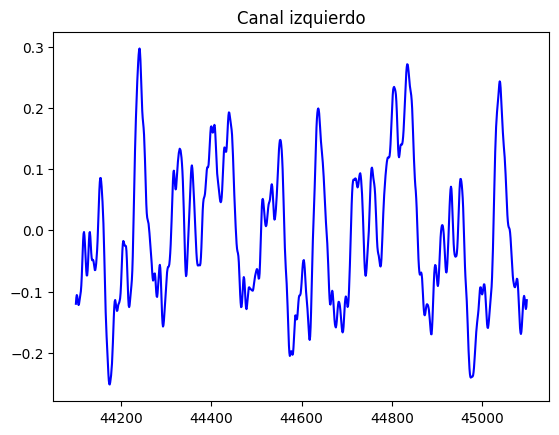

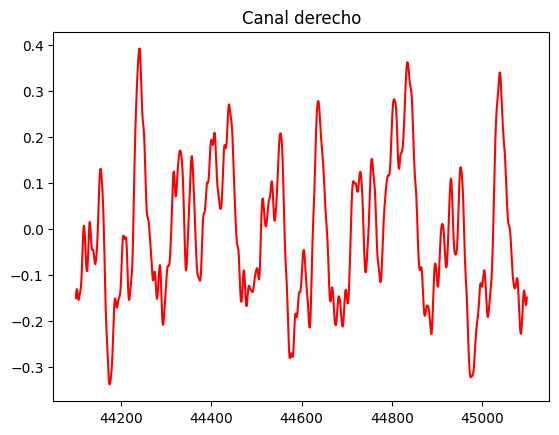

In [ ]:
#Graficar
#Cambia los valores de n y offset para ver la señal en diferentes intervalos y zoom (ejm. n=500, offset=1000)
#El eje X está en muestras del vector de audio, cómo lo muestras en segundos?
#Visualiza los primeros 3 segundos de la señal, que n pondrías?

n= 1000    #TBD #Para determinar el número de muestras a graficar
offset= 44100    #TBD #Para empezar de cualquier parte del vector
time=np.arange(offset,offset+n)
plt.title("Canal izquierdo")
plt.plot(time, y[0, offset:(offset+n)], color='b')
plt.show()

plt.title("Canal derecho")
plt.plot(time, y[1, offset:(offset+n)], color='r')
plt.show()

# Respuesta en frecuencia **

In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filename = "/content/drive/MyDrive/Datasets/NotaGuitarra.wav"
print(filename)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
nota, sr = librosa.load(filename, sr=None, mono=True) # mono false para dos

# 3. Reproducir audio
Audio(data=nota, rate=sr ) #TBD Qué variable debe ir en "rate"?

/content/drive/MyDrive/Datasets/NotaGuitarra.wav


In [ ]:
# Calcular la FFT de la nota de guitarra  /Calcula la transformada de fourier
fft_result = np.fft.fft(nota)

# Obtener las magnitudes (espectro de amplitud)
magnitude = np.abs(fft_result)

# Frecuencias correspondientes (eje x)
freqs = np.fft.fftfreq(len(nota), 1/sr)

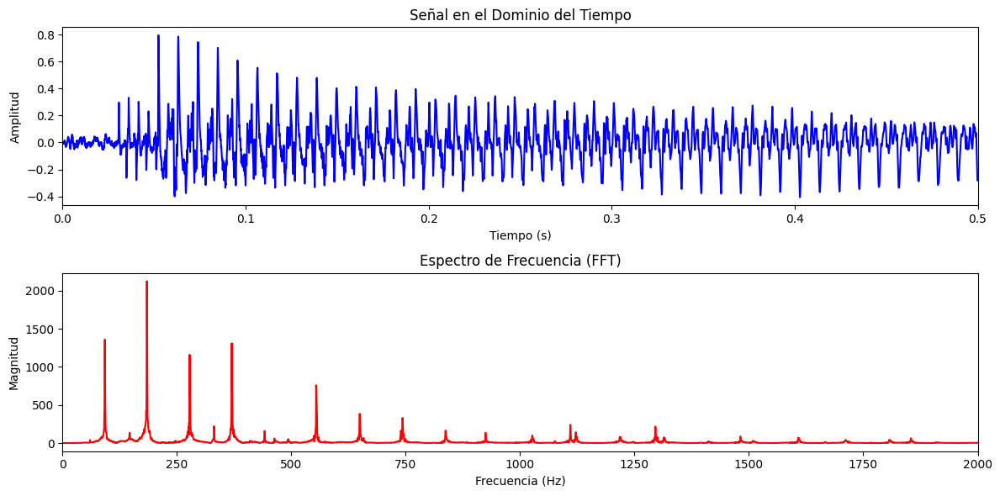

In [ ]:
#Graficar respuesta en el tiempo y frecuencia de nota de guitarra
t = np.linspace(0, 1, sr)
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(t, nota[0:44100], color='b') #TBD #Pregunta al grupo: Porqué 44100?
plt.title("Señal en el Dominio del Tiempo")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.xlim(0, 0.5)  # Mostrar solo los primeros 500ms
plt.subplot(2, 1, 2)
plt.plot(freqs[:len(freqs)//2], magnitude[:len(freqs)//2], color='r')  # Solo frecuencias positivas
plt.title("Espectro de Frecuencia (FFT)")
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Magnitud")
plt.xlim(0, 2000)  # Mostrar hasta 2 kHz (para ver los picos) #TBD cambiar límites para enforcarse en un rango específico
plt.tight_layout()
plt.show()

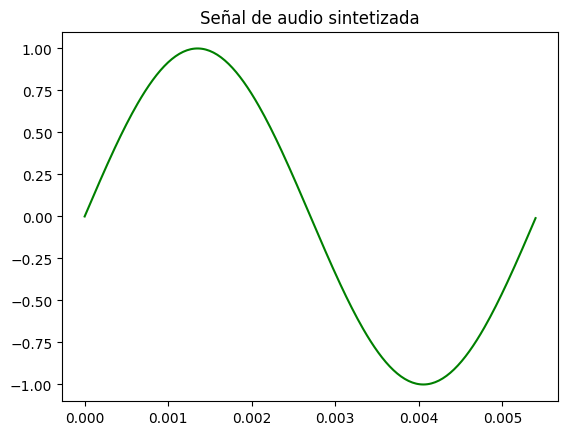

In [ ]:
# Simular una señal int16 (rango válido)
sr = 44100
n= 239   #TBD Cuántas muestras deben colocarse para ver aprox. solo 1 periodo de la señal senoidal?
t = np.linspace(0, 1, sr)
#sim = np.int16(32767 * 0.5 * np.sin(2 * np.pi * 185 * t))  # Señal sinusoidal 185Hz en int16
sim = np.sin(2 * np.pi * 185 * t)  # Señal sinusoidal 185Hz en float32
plt.title("Señal de audio sintetizada")
plt.plot(t[0:n], sim[0:n], color='g')
plt.show()

Audio(data=sim, rate=sr)

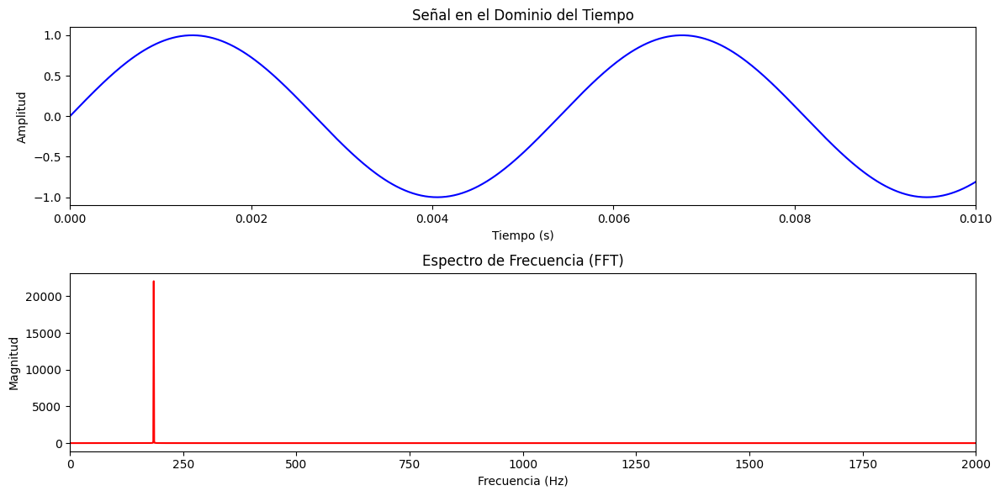

In [ ]:
# Calcular la FFT de la nota sintetizada
fft_result = np.fft.fft(sim)

# Obtener las magnitudes (espectro de amplitud)
magnitude = np.abs(fft_result)

# Frecuencias correspondientes (eje x)
freqs = np.fft.fftfreq(len(sim), 1/sr)

#Graficar respuesta en el tiempo y frecuencia de nota de guitarra
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(t, sim, color='b') #Porqué ya no es necesario determinar la cantidad de muestras?
plt.title("Señal en el Dominio del Tiempo")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.xlim(0, 0.01)  # Mostrar solo los primeros 10 ms
plt.subplot(2, 1, 2)
plt.plot(freqs[:len(freqs)//2], magnitude[:len(freqs)//2], color='r')  # Solo frecuencias positivas
plt.title("Espectro de Frecuencia (FFT)")
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Magnitud")
plt.xlim(0, 2000)  # Mostrar hasta 2 kHz (para ver los picos)
plt.tight_layout()
plt.show()

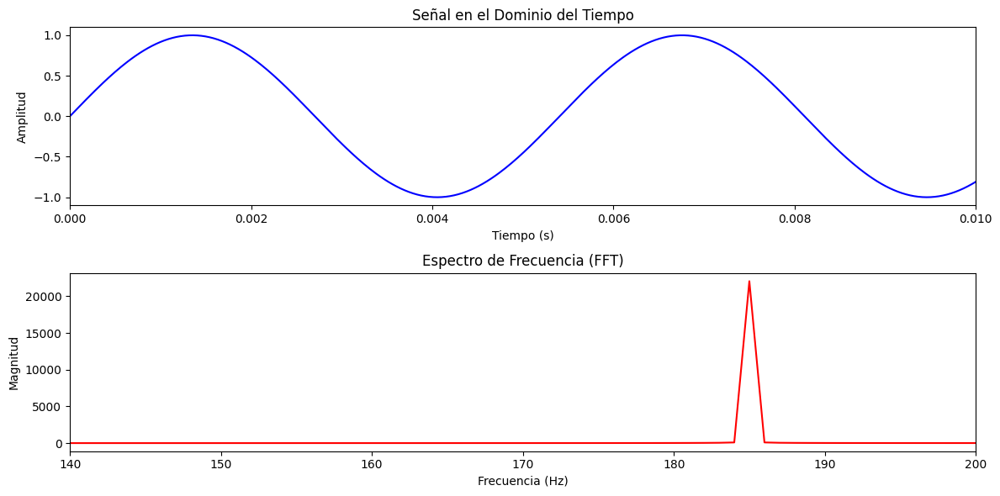

In [ ]:
# Calcular la FFT de la nota sintetizada
fft_result = np.fft.fft(sim)

# Obtener las magnitudes (espectro de amplitud)
magnitude = np.abs(fft_result)

# Frecuencias correspondientes (eje x)
freqs = np.fft.fftfreq(len(sim), 1/sr)

#Graficar respuesta en el tiempo y frecuencia de nota de guitarra
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(t, sim, color='b') #Porqué ya no es necesario determinar la cantidad de muestras?
plt.title("Señal en el Dominio del Tiempo")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.xlim(0, 0.01)  # Mostrar solo los primeros 10 ms
plt.subplot(2, 1, 2)
plt.plot(freqs[:len(freqs)//2], magnitude[:len(freqs)//2], color='r')  # Solo frecuencias positivas
plt.title("Espectro de Frecuencia (FFT)")
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Magnitud")
plt.xlim(140, 200)  # Mostrar hasta 2 kHz (para ver los picos)   ZOOM
plt.tight_layout()
plt.show()

# Cambiar Frecuencia de muestreo Fs

In [ ]:
sr_16=16000

y_16k = librosa.resample(y, orig_sr=sr, target_sr=sr_16)
print(y.shape, y_16k.shape)

Audio(data=y_16k, rate=sr_16) #TBD prueba otras frecuencias de muestreo

(2, 1174824) (2, 426240)


In [ ]:
sr_16=16000

y_16k = librosa.resample(y, orig_sr=sr, target_sr=sr_16)
print(y.shape, y_16k.shape)

Audio(data=y_16k, rate=sr) #TBD prueba otras frecuencias de muestreo

(2, 1174824) (2, 426240)


# Cambiar tipos de compresión (formatos) y guardar archivos

In [ ]:
y_16k = y_16k.T #Reorganizar vector para poder guardar audio stereo. #recordar la forma para posteriores grabaciones estereo
print(y_16k.shape)
sf.write("Guitarra_16KHz.wav", y_16k, sr_16 )

(426240, 2)


In [ ]:
# Guardar en otro formato (ej: WAV, FLAC, OGG)
#No es necesario reorganizar porque los audios son mono
print(nota.shape)
sf.write("audio_convertido.wav", nota, sr)  # WAV
sf.write("audio_convertido.flac", nota, sr)  # FLAC
sf.write("audio_convertido.ogg", nota, sr)  # OGG (requiere libsndfile)

(107369,)


# Funciones para modificar batches de audio en directorios

In [ ]:
files=os.listdir("AudiosEx")
print(files)

FileNotFoundError: [Errno 2] No such file or directory: 'AudiosEx'

In [ ]:
def t_resample(y, o_sr,t_sr,f):
    y_rs = librosa.resample(y, orig_sr=o_sr, target_sr=t_sr)
    sf.write('AudiosEx/resampled/'+'rs_'+f, y_rs, t_sr)

In [ ]:
#Resample
target_sr=16000
for i in tqdm(range(len(files))):
    f = files[i]
    if os.path.isfile('AudiosEx/'+f):
        y, sr = librosa.load('AudiosEx/'+files[i], sr=None)
        t_resample(y,sr,target_sr,f)

NameError: name 'files' is not defined

## Ejercicios
1. Grábate diciendo sólo uno de tus nombres (1 seg aprox. un audio muy corto)
2. Graba un segundo tocando la puerta de tu casa
3. Graba un tercer sonido que tu quieras y consideres un sonido agudo (cantado, del entorno, etc.) (1 seg aprox).
4. Carga los audios y obten un gráfico útil de la respuesta en tiempo y frecuencia de los 3
5. Cambia la frecuencia de muestreo de todos a 16KHz.
6. Salva los audios en formato wav.

Reflexiona:
¿Notas alguna diferencia en los audios después de cambiar la Fs?
¿Comprendes cómo se compone la señal en frecuencia, su fundamental y armónicos?
Sube en el foro fotos de tus 6 gráficos (2 por cada audio, indica en el título qué sonido es) y comparte tus reflexiones para que el resto de los compañeros lo vea y pueda ser calificado.


# Funciones para aumento de datos
### Lo siguiente no es parte de la sesión, pero se verá en dado caso que sea útil para el resto. Solo se mencionará su uso sin entrar mucho a profundidad.

In [ ]:
y_pitchs = librosa.effects.pitch_shift(y, sr=sr, n_steps=3) #-1.5,-3,1.5,3
y_16k = librosa.resample(y_pitchs, orig_sr=sr, target_sr=sr_16)
#sf.write('2-70052-B-42_16k.wav', y_16k, sr_16 )
Audio(data=y_pitchs, rate=sr)

In [ ]:
y_fast = librosa.effects.time_stretch(y, rate=1.5) #0.7, 1.5
Audio(data=y_fast, rate=sr)

In [ ]:
def t_stretch(y,f):
    y_s = librosa.effects.time_stretch(y, rate=1.5)
    sf.write('Audios/speed/'+'r_'+f, y_s, sr)
    y_s = librosa.effects.time_stretch(y, rate=0.7)
    sf.write('Audios/speed/'+'l_'+f, y_s, sr)

In [ ]:
def t_pitch(y, sr, f):
    y_m15 = librosa.effects.pitch_shift(y, sr=sr, n_steps=-1.5)
    sf.write('Audios/pitch/'+'m15_'+f, y_m15, sr)
    y_m30 = librosa.effects.pitch_shift(y, sr=sr, n_steps=-3.0)
    sf.write('Audios/pitch/'+'m30_'+f, y_m30, sr)
    y_a15 = librosa.effects.pitch_shift(y, sr=sr, n_steps= 1.5)
    sf.write('Audios/pitch/'+'a15_'+f, y_a15, sr)
    y_a30 = librosa.effects.pitch_shift(y, sr=sr, n_steps= 3.0)
    sf.write('Audios/pitch/'+'a30_'+f, y_a30, sr)

In [ ]:
def t_pitch_stretch(y, sr, f):
    y_m30 = librosa.effects.pitch_shift(y, sr=sr, n_steps=-3.0)
    y_s = librosa.effects.time_stretch(y_m30, rate=0.7)
    sf.write('Audios/pitch_speed/'+'lm_'+f, y_s, sr)
    y_s = librosa.effects.time_stretch(y_m30, rate=1.5)
    sf.write('Audios/pitch_speed/'+'rm_'+f, y_s, sr)

    y_a30 = librosa.effects.pitch_shift(y, sr=sr, n_steps=3.0)
    y_s = librosa.effects.time_stretch(y_a30, rate=0.7)
    sf.write('Audios/pitch_speed/'+'la_'+f, y_s, sr)
    y_s = librosa.effects.time_stretch(y_a30, rate=1.5)
    sf.write('Audios/pitch_speed/'+'ra_'+f, y_s, sr)

In [ ]:
#Modify
for i in tqdm(range(len(files))):
    f = files[i]
    if os.path.isfile('Audios/'+f):
        y, sr = librosa.load('Audios/'+files[i], sr=16000)
        t_pitch(y,sr,f)
        t_stretch(y,f)
        t_pitch_stretch(y,sr,f)

100%|██████████████████████████████████████████████████████████████████████████████████| 74/74 [02:43<00:00,  2.21s/it]


# TAREA 1

## Audio 1: Nombre

In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filenameN = "/content/drive/MyDrive/Datasets/nombre_flac.flac"
print(filenameN)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
y, sr = librosa.load(filenameN, sr=None, mono=False)

#Completa el siguiente código para que muestre lo indicado
print("Frecuencia de muestreo:", sr ) #TBD
print("Tipo de dato: ", y.dtype)   #TBD
print("Forma del vector y:", y.shape )   #TBD
print("Primeros 5 valores de ambos canales:",)   #TBD

# Verifica si el audio es mono o stereo y muestra los primeros 5 valores
if y.ndim == 1:
    print("Primeros 5 valores del canal:", y[:5]) # Audio mono
else:
    print("Primeros 5 valores de ambos canales:", y[:,:5]) # Audio stereo

# 3. Reproducir audio
Audio(data=y, rate=sr)

/content/drive/MyDrive/Datasets/nombre_flac.flac
Frecuencia de muestreo: 16000
Tipo de dato:  float32
Forma del vector y: (34143,)
Primeros 5 valores de ambos canales:
Primeros 5 valores del canal: [ 0.0000000e+00  0.0000000e+00  3.0517578e-05 -3.0517578e-05
  6.1035156e-05]


### Respuesta en Tiempo N

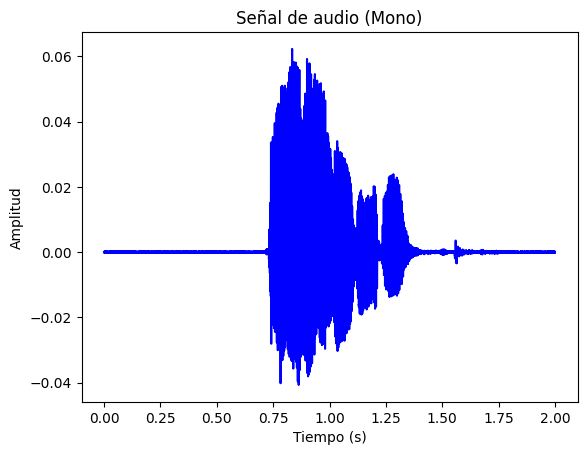

In [ ]:
#Graficar
#Cambia los valores de n y offset para ver la señal en diferentes intervalos y zoom (ejm. n=500, offset=1000)
#El eje X está en muestras del vector de audio, cómo lo muestras en segundos?
#Visualiza los primeros 3 segundos de la señal, que n pondrías?

# Adjusted n and offset for plotting based on the audio length (around 34143 samples)
# n = 50000 is too large for an audio with 34143 samples.
# Let's choose a smaller value for n, for example, to visualize a part of the audio.
# To visualize 3 seconds, n should be 3 * sr. Assuming a common sr like 22050, n would be 66150, which is still larger than 34143.
# Let's adjust n to be at most the length of the audio from the offset.
# offset= 1000 # Keep the offset as is, but ensure offset + n does not exceed the audio length.
# To show the first 3 seconds, offset would be 0 and n would be 3 * sr.
# If the audio is shorter than 3 seconds, n should be the length of the audio.

# Define n and offset - example values for plotting a part of the audio
# Let's set n to a reasonable value to see some detail, like 5000 samples.
# And let's keep offset at 1000.
#n = 5000
#offset = 1000

# To visualize 3 seconds:
n = min(len(y) - offset, 2 * sr)
offset = 0 # To start from the beginning

time = np.arange(offset, offset + n) / sr # Convert samples to seconds for the x-axis

# Check if the audio is mono (1D) or stereo (2D) and plot accordingly
if y.ndim == 1:
    plt.title("Señal de audio (Mono)")
    # Ensure the slice does not go beyond the array bounds
    plt.plot(time, y[offset:offset+n], color='b')
    plt.xlabel("Tiempo (s)") # Add x-axis label
    plt.ylabel("Amplitud") # Add y-axis label
    plt.show()
elif y.ndim == 2:
    plt.title("Canal izquierdo")
    # Ensure the slice does not go beyond the array bounds
    plt.plot(time, y[0, offset:(offset+n)], color='b')
    plt.xlabel("Tiempo (s)") # Add x-axis label
    plt.ylabel("Amplitud") # Add y-axis label
    plt.show()

    plt.title("Canal derecho")
    # Ensure the slice does not go beyond the array bounds
    plt.plot(time, y[1, offset:(offset+n)], color='r')
    plt.xlabel("Tiempo (s)") # Add x-axis label
    plt.ylabel("Amplitud") # Add y-axis label
    plt.show()
else:
    print("Audio data has an unexpected number of dimensions:", y.ndim)

### Respuesta en frecuencia N

In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filenameNa = "/content/drive/MyDrive/Datasets/nombre_flac.flac"
print(filenameNa)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
nota, sr = librosa.load(filenameNa, sr=None, mono=True) # mono false para dos

# 3. Reproducir audio
Audio(data=nota, rate=sr ) #TBD Qué variable debe ir en "rate"?

/content/drive/MyDrive/Datasets/nombre_flac.flac


In [ ]:
# Calcular la FFT de la nota de guitarra  /Calcula la transformada de fourier
fft_result = np.fft.fft(nota)

# Obtener las magnitudes (espectro de amplitud)
magnitude = np.abs(fft_result)

# Frecuencias correspondientes (eje x)
freqs = np.fft.fftfreq(len(nota), 1/sr)

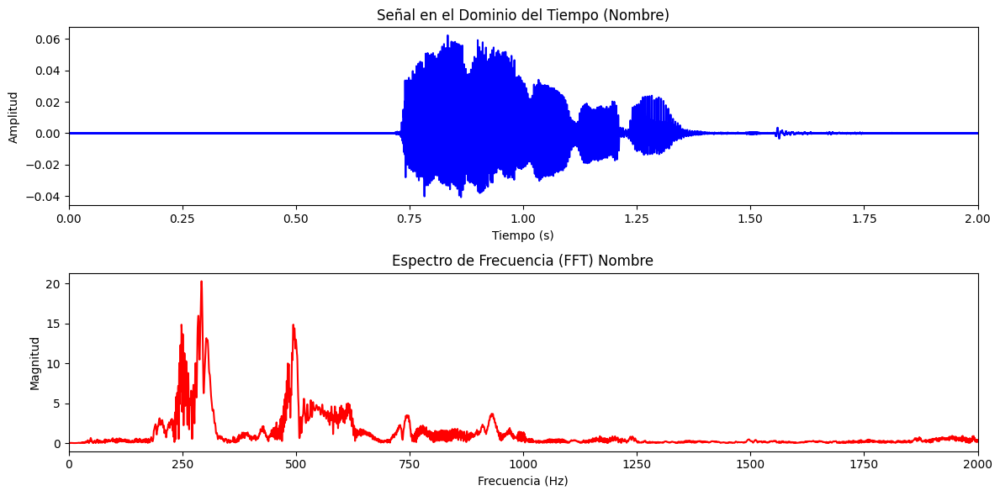

In [ ]:
#Graficar respuesta en el tiempo y frecuencia de nota de guitarra
t = np.linspace(0, len(nota) / sr, len(nota))
plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
plt.plot(t, nota[0:44100], color='b') #TBD #Pregunta al grupo: Porqué 44100?
plt.title("Señal en el Dominio del Tiempo (Nombre)")
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.xlim(0, 2.0)  # Mostrar solo los primeros 500ms
plt.subplot(2, 1, 2)
plt.plot(freqs[:len(freqs)//2], magnitude[:len(freqs)//2], color='r')  # Solo frecuencias positivas
plt.title("Espectro de Frecuencia (FFT) Nombre")
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Magnitud")
plt.xlim(0, 2000)  # Mostrar hasta 2 kHz (para ver los picos) #TBD cambiar límites para enforcarse en un rango específico
plt.tight_layout()
plt.show()

## Audio 2: Puerta

In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filenameP = "/content/drive/MyDrive/Datasets/puerta_flac.flac"
print(filenameP)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
y, sr = librosa.load(filenameP, sr=None, mono=False)

#Completa el siguiente código para que muestre lo indicado
print("Frecuencia de muestreo:", sr ) #TBD
print("Tipo de dato: ", y.dtype)   #TBD
print("Forma del vector y:", y.shape )   #TBD
print("Primeros 5 valores de ambos canales:",)   #TBD

# Verifica si el audio es mono o stereo y muestra los primeros 5 valores
if y.ndim == 1:
    print("Primeros 5 valores del canal:", y[:5]) # Audio mono
else:
    print("Primeros 5 valores de ambos canales:", y[:,:5]) # Audio stereo

# 3. Reproducir audio
Audio(data=y, rate=sr)

/content/drive/MyDrive/Datasets/puerta_flac.flac
Frecuencia de muestreo: 44100
Tipo de dato:  float32
Forma del vector y: (2, 91547)
Primeros 5 valores de ambos canales:
Primeros 5 valores de ambos canales: [[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.0517578e-05]]


### Respuesta en tiempo P

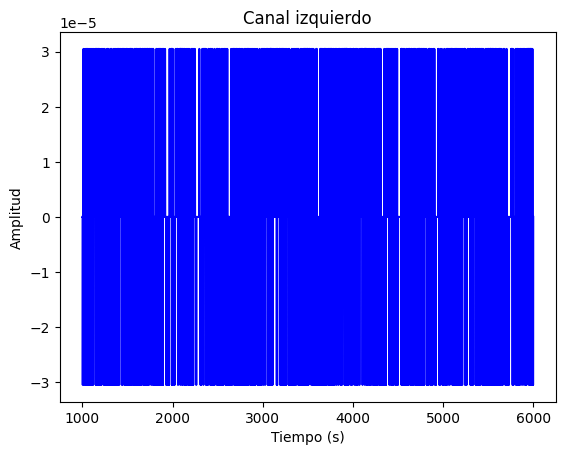

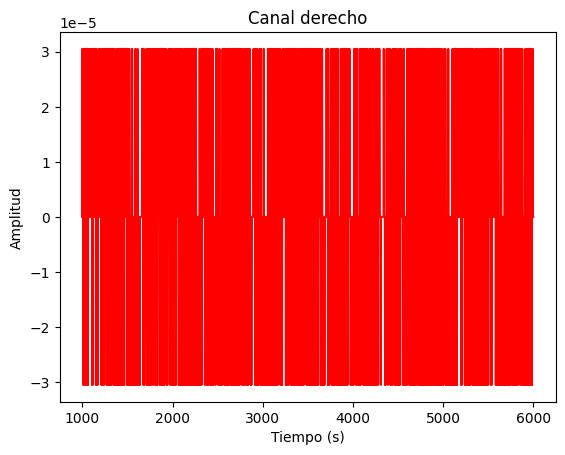

In [ ]:
#Graficar
#Cambia los valores de n y offset para ver la señal en diferentes intervalos y zoom (ejm. n=500, offset=1000)
#El eje X está en muestras del vector de audio, cómo lo muestras en segundos?
#Visualiza los primeros 3 segundos de la señal, que n pondrías?

# Adjusted n and offset for plotting based on the audio length (around 34143 samples)
# n = 50000 is too large for an audio with 34143 samples.
# Let's choose a smaller value for n, for example, to visualize a part of the audio.
# To visualize 3 seconds, n should be 3 * sr. Assuming a common sr like 22050, n would be 66150, which is still larger than 34143.
# Let's adjust n to be at most the length of the audio from the offset.
# offset= 1000 # Keep the offset as is, but ensure offset + n does not exceed the audio length.
# To show the first 3 seconds, offset would be 0 and n would be 3 * sr.
# If the audio is shorter than 3 seconds, n should be the length of the audio.

# Define n and offset - example values for plotting a part of the audio
# Let's set n to a reasonable value to see some detail, like 5000 samples.
# And let's keep offset at 1000.
n = 5000
offset = 1000

# To visualize 2 seconds:
#n = min(len(y) - offset, 2 * sr)
#offset = 0 # To start from the beginning

timeP = np.arange(offset, offset + n) #/ sr # Convert samples to seconds for the x-axis

# Check if the audio is mono (1D) or stereo (2D) and plot accordingly
if y.ndim == 1:
    plt.title("Señal de audio (Mono)")
    # Ensure the slice does not go beyond the array bounds
    plt.plot(time, y[offset:offset+n], color='b')
    plt.xlabel("Tiempo (s)") # Add x-axis label
    plt.ylabel("Amplitud") # Add y-axis label
    plt.show()
elif y.ndim == 2:
    plt.title("Canal izquierdo")
    # Ensure the slice does not go beyond the array bounds
    plt.plot(timeP, y[0, offset:(offset+n)], color='b')
    plt.xlabel("Tiempo (s)") # Add x-axis label
    plt.ylabel("Amplitud") # Add y-axis label
    plt.show()

    plt.title("Canal derecho")
    # Ensure the slice does not go beyond the array bounds
    plt.plot(timeP, y[1, offset:(offset+n)], color='r')
    plt.xlabel("Tiempo (s)") # Add x-axis label
    plt.ylabel("Amplitud") # Add y-axis label
    plt.show()
else:
    print("Audio data has an unexpected number of dimensions:", y.ndim)

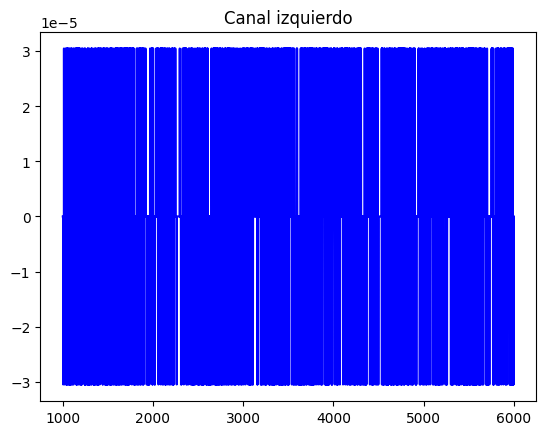

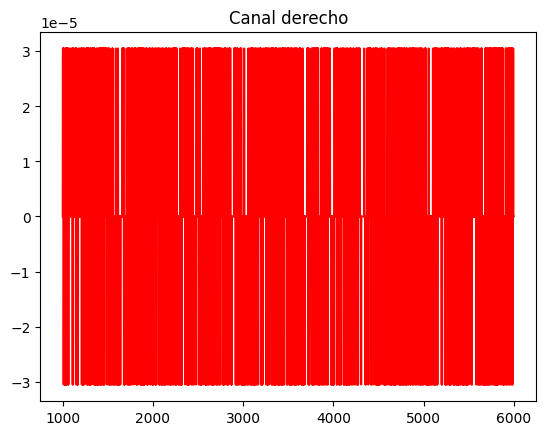

In [ ]:
#Graficar
#Cambia los valores de n y offset para ver la señal en diferentes intervalos y zoom (ejm. n=500, offset=1000)
#El eje X está en muestras del vector de audio, cómo lo muestras en segundos?
#Visualiza los primeros 3 segundos de la señal, que n pondrías?

nP= 50000    #TBD #Para determinar el número de muestras a graficar
offset= 1000    #TBD #Para empezar de cualquier parte del vector
time=np.arange(offset,offset+nP)
plt.title("Canal izquierdo")
plt.plot(timeP, y[0, offset:(offset+n)], color='b')
plt.show()

plt.title("Canal derecho")
plt.plot(timeP, y[1, offset:(offset+n)], color='r')
plt.show()

### Respuesta en frecuencia P

In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filenamePu = "/content/drive/MyDrive/Datasets/puerta_flac.flac"
print(filenamePu)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
notaPu, sr = librosa.load(filenamePu, sr=None, mono=True) # mono false para dos

# 3. Reproducir audio
Audio(data=notaPu, rate=sr ) #TBD Qué variable debe ir en "rate"?

/content/drive/MyDrive/Datasets/puerta_flac.flac


In [ ]:
# Calcular la FFT de la nota de guitarra  /Calcula la transformada de fourier
fft_result = np.fft.fft(notaPu)

# Obtener las magnitudes (espectro de amplitud)
magnitude = np.abs(fft_result)

# Frecuencias correspondientes (eje x)
freqs = np.fft.fftfreq(len(notaPu), 1/sr)

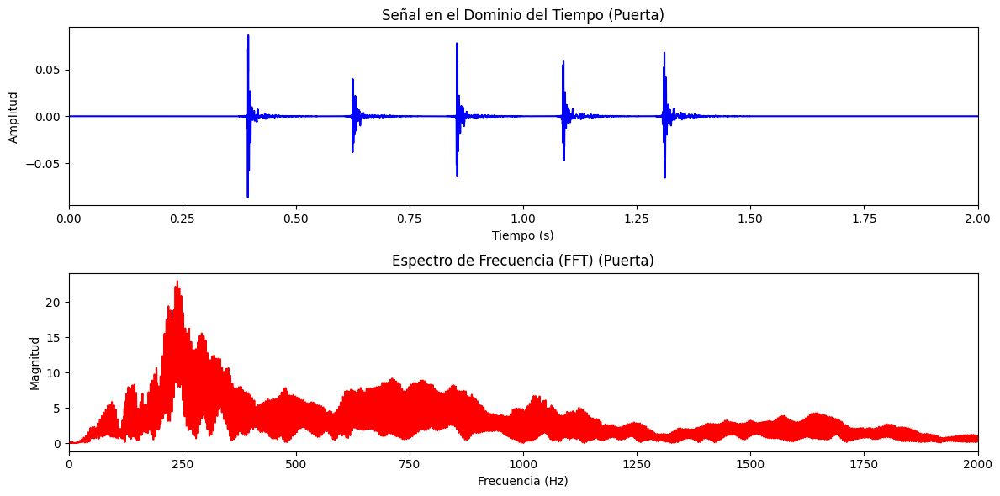

In [ ]:
#Graficar respuesta en el tiempo y frecuencia de nota de guitarra
# Calculate the time vector for the full audio length
tPu = np.linspace(0, len(notaPu) / sr, len(notaPu))

plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
# Plot the full audio data against the full time vector
# If you want to plot the first 2 seconds (as per xlim), calculate the number of samples for 2 seconds
samples_to_plot = int(2.0 * sr)
# Ensure the slice doesn't exceed the array bounds
samples_to_plot = min(samples_to_plot, len(notaPu))
plt.plot(tPu[:samples_to_plot], notaPu[:samples_to_plot], color='b')
plt.title("Señal en el Dominio del Tiempo (Puerta)") # Add title indicating which audio
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.xlim(0, 2.0)  # Mostrar solo los primeros 2 segundos
plt.subplot(2, 1, 2)
plt.plot(freqs[:len(freqs)//2], magnitude[:len(freqs)//2], color='r')  # Solo frecuencias positivas
plt.title("Espectro de Frecuencia (FFT) (Puerta)") # Add title indicating which audio
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Magnitud")
plt.xlim(0, 2000)  # Mostrar hasta 2 kHz (para ver los picos)
plt.tight_layout()
plt.show()

## Audio 3: Agudo

In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filenameP = "/content/drive/MyDrive/Datasets/agudo_flac.flac"
print(filenameP)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
y, sr = librosa.load(filenameP, sr=None, mono=False)

#Completa el siguiente código para que muestre lo indicado
print("Frecuencia de muestreo:", sr ) #TBD
print("Tipo de dato: ", y.dtype)   #TBD
print("Forma del vector y:", y.shape )   #TBD
print("Primeros 5 valores de ambos canales:",)   #TBD

# Verifica si el audio es mono o stereo y muestra los primeros 5 valores
if y.ndim == 1:
    print("Primeros 5 valores del canal:", y[:5]) # Audio mono
else:
    print("Primeros 5 valores de ambos canales:", y[:,:5]) # Audio stereo

# 3. Reproducir audio
Audio(data=y, rate=sr)

/content/drive/MyDrive/Datasets/agudo_flac.flac
Frecuencia de muestreo: 44100
Tipo de dato:  float32
Forma del vector y: (2, 95387)
Primeros 5 valores de ambos canales:
Primeros 5 valores de ambos canales: [[0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00]
 [0.0000000e+00 0.0000000e+00 0.0000000e+00 0.0000000e+00 3.0517578e-05]]


### Respuesta en frecuencia A

In [ ]:
#Cargar audio con librosa
# 1. Ruta del archivo
filenameAg = "/content/drive/MyDrive/Datasets/agudo_flac.flac"
print(filenameAg)

# 2. Cargar forma de audio en la variable "y" frecuencia de muestreo "sr"
notaAg, sr = librosa.load(filenameAg, sr=None, mono=True) # mono false para dos

# 3. Reproducir audio
Audio(data=notaAg, rate=sr ) #TBD Qué variable debe ir en "rate"?

/content/drive/MyDrive/Datasets/agudo_flac.flac


In [ ]:
# Calcular la FFT de la nota de guitarra  /Calcula la transformada de fourier
fft_resultAg = np.fft.fft(notaAg)

# Obtener las magnitudes (espectro de amplitud)
magnitudeAg = np.abs(fft_resultAg)

# Frecuencias correspondientes (eje x)
freqsAg = np.fft.fftfreq(len(notaAg), 1/sr)

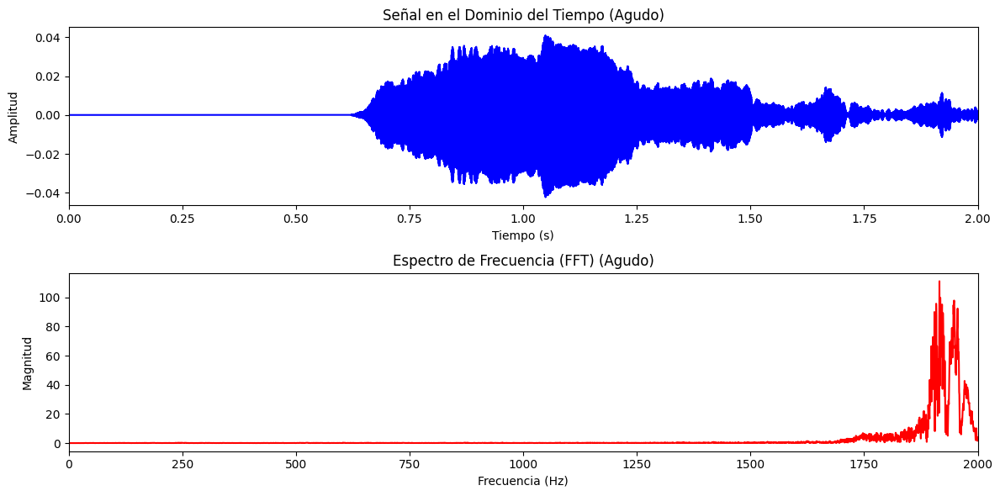

In [ ]:
#Graficar respuesta en el tiempo y frecuencia de nota de guitarra
# Calculate the time vector for the full audio length
tAg = np.linspace(0, len(notaAg) / sr, len(notaAg))

plt.figure(figsize=(12, 6))
plt.subplot(2, 1, 1)
# Plot the full audio data against the full time vector
# If you want to plot the first 2 seconds (as per xlim), calculate the number of samples for 2 seconds
samples_to_plot = int(2.0 * sr)
# Ensure the slice doesn't exceed the array bounds
samples_to_plot = min(samples_to_plot, len(notaAg))
plt.plot(tAg[:samples_to_plot], notaAg[:samples_to_plot], color='b')
plt.title("Señal en el Dominio del Tiempo (Agudo)") # Add title indicating which audio
plt.xlabel("Tiempo (s)")
plt.ylabel("Amplitud")
plt.xlim(0, 2.0)  # Mostrar solo los primeros 2 segundos
plt.subplot(2, 1, 2)
plt.plot(freqs[:len(freqs)//2], magnitudeAg[:len(freqs)//2], color='r')  # Solo frecuencias positivas
plt.title("Espectro de Frecuencia (FFT) (Agudo)") # Add title indicating which audio
plt.xlabel("Frecuencia (Hz)")
plt.ylabel("Magnitud")
plt.xlim(0, 2000)  # Mostrar hasta 2 kHz (para ver los picos)
plt.tight_layout()
plt.show()